# Investigate NN Performance on Individual Tracks

In [1]:
from __future__ import print_function

import tools.plot_detector_tools
from tools.plot_detector_tools import EventPlotter
import numpy as np

from tools.NN_performance_utils import top_k_accuracy_score, list_k_fails
from tools.batching_v5 import ModuleHit

import tensorflow as tf
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
sess = tf.Session(config=config)
import keras as keras
from keras import backend as K
from keras.models import load_model

from itertools import cycle
import matplotlib
import matplotlib.pyplot as plt

/usr/local/lib/python2.7/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


Load model and other utility classes

In [2]:
detector_file = '../TrackML_data/detectors.csv'
event_file = '/data1/users/jcollins/TrackML/data/event000001000'
mh = ModuleHit([event_file], detector_file, std_scale = True)
myplotter = EventPlotter(event_file,detector_file)

model_filename = '/data1/users/jcollins/TrackML/stage_1/A0010b_1000.h5'
model = load_model(model_filename)
#x, y_true, lengths, weights = mh.get_entire_event_for_NN_eval()

## First lets investigate a nice track.

Get the top 10 predictions for every hit in the track.

In [10]:
track_id = 4504011944230912.0
track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Define a mapping between prediction confidence and opacity in plots

In [11]:
def alphafunc(x):
    return max(0.6*(np.log10(x) - np.log10(0.003))/(np.log10(1)-np.log10(0.003)),0)

Start with the first few hits in the inner detector

Prediction for hit no. 2:


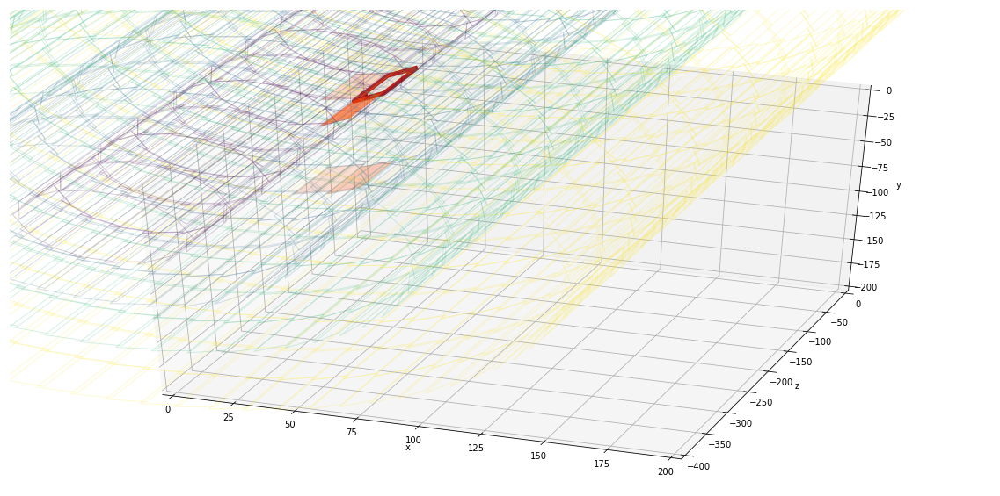

Prediction for hit no. 3:


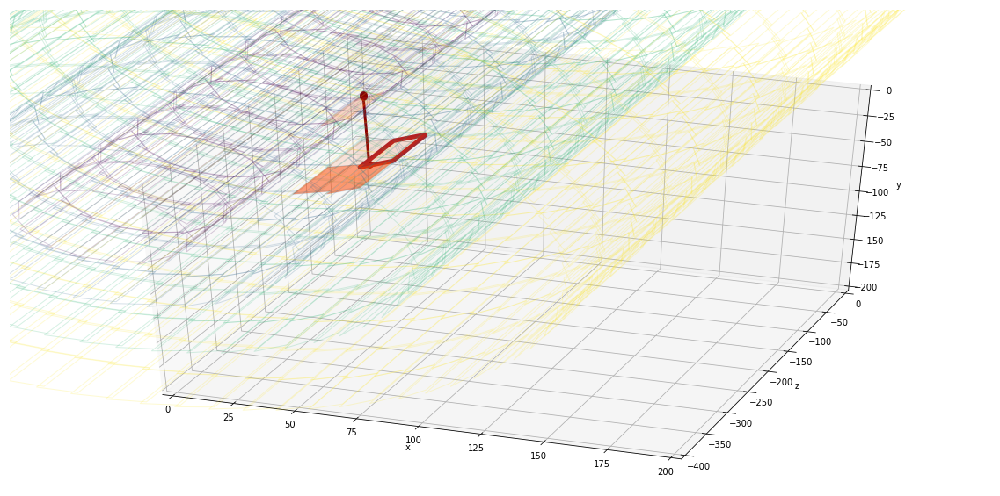

Prediction for hit no. 4:


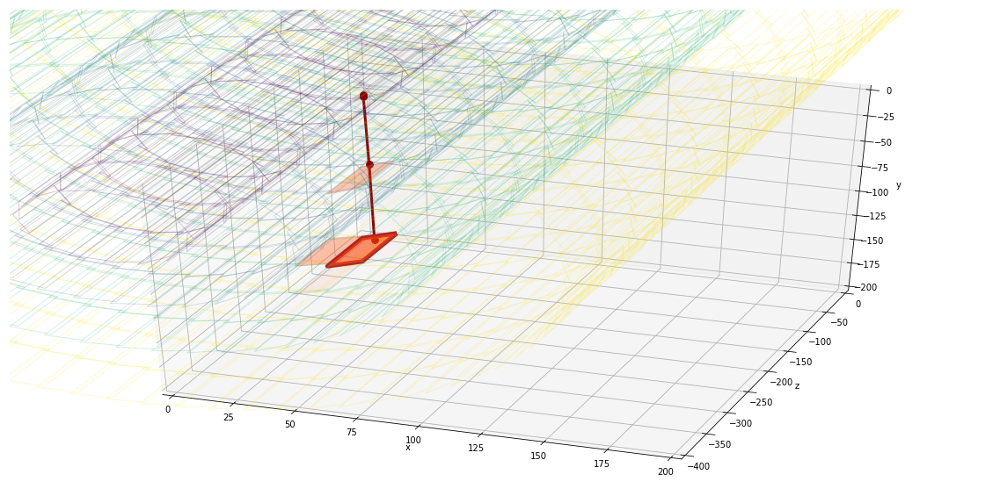

Prediction for hit no. 5:


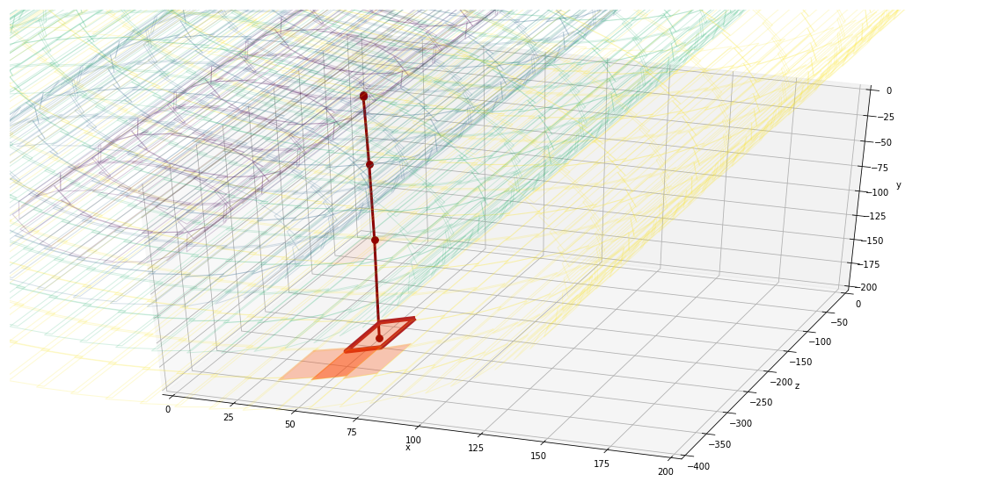

In [12]:
for hit in range(2,6):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [8], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
    ax.view_init(40, -70)
    ax.set_xlim([0,200])
    ax.set_zlim([-200,0])
    ax.set_ylim([-400,0])
    plt.show()

##### Commentary:

1) Hit 4 was spot on.

2) Hit 2 was a tricky double hit, potentially a quadruple hit since the first hit was around the corner of four modules. It did pretty well on this, even with minimal track information. It also seems to know there is a lot of uncertainty on this one.

3) Hit 3 seems like it should have been able to do a better job

4) Hit 5 was fine.

Prediction for hit no. 6:


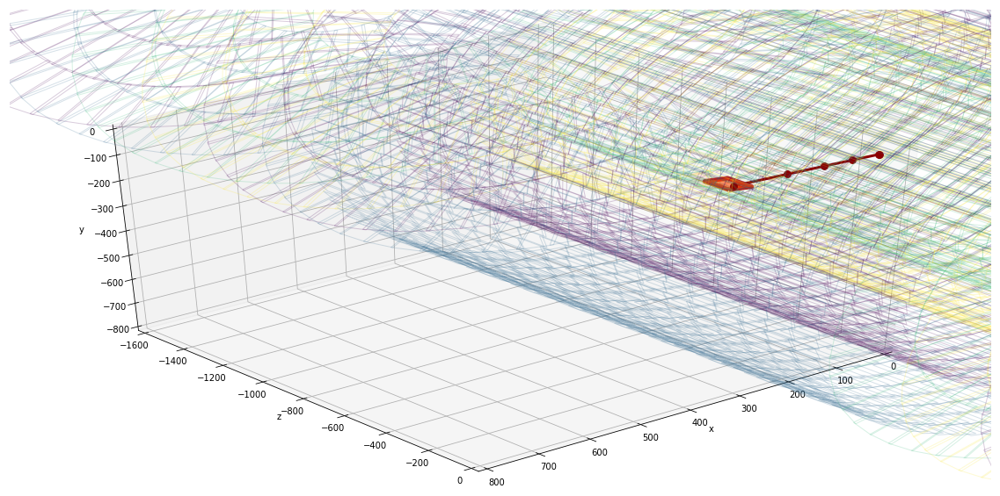

Prediction for hit no. 7:


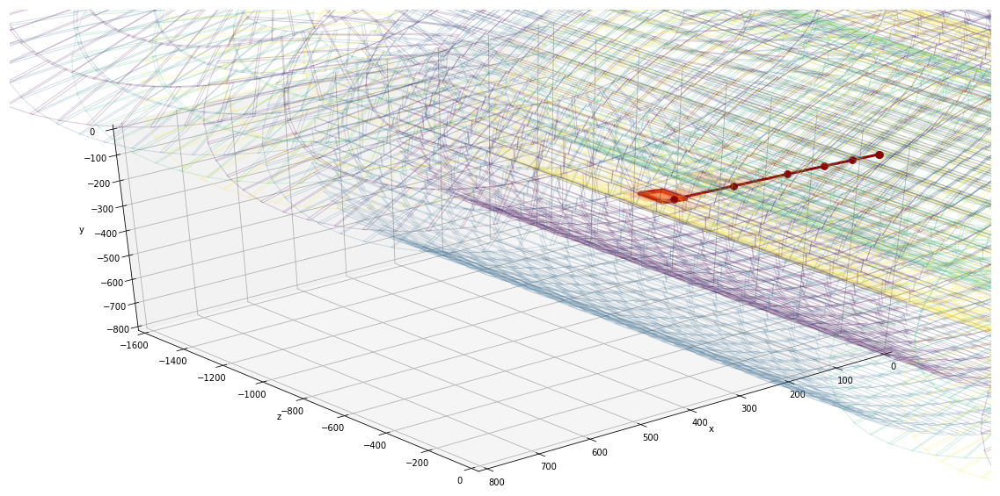

Prediction for hit no. 8:


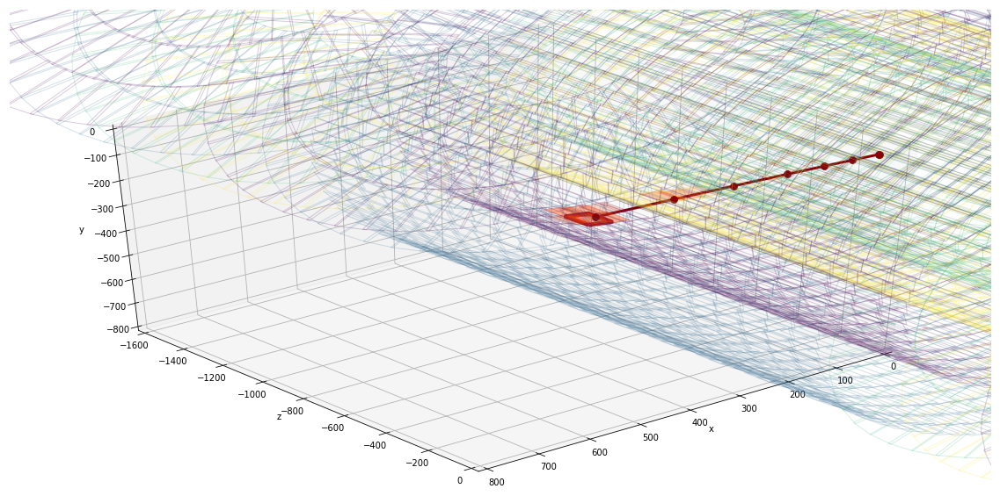

Prediction for hit no. 9:


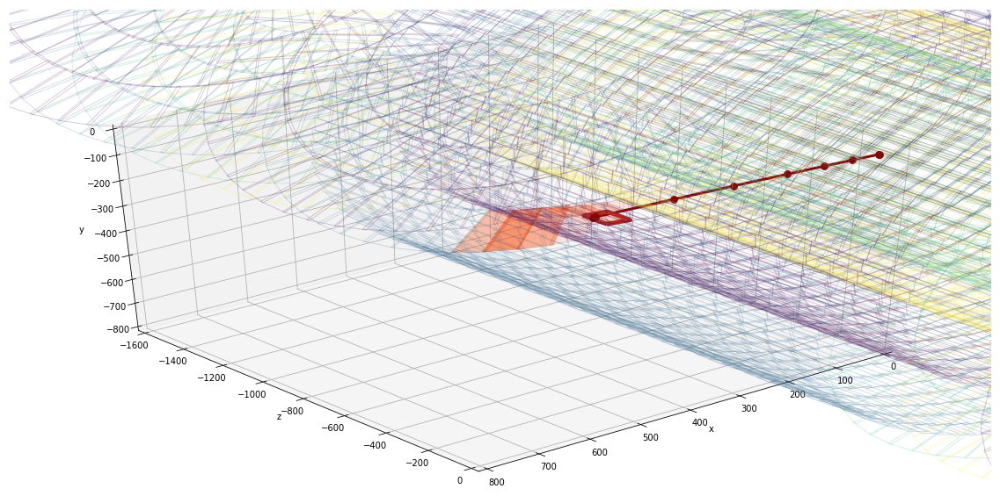

In [14]:
for hit in range(6,10):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,13,14], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
    ax.set_xlim([0,800])
    ax.set_zlim([-800,0])
    ax.set_ylim([-1600,0])
    ax.view_init(40, 50)
    plt.show()

##### Commentary:

All the predictions were pretty good here. Hit 9 was tricky because it was a double-hit at a shallow angle, but I think I detect some non-zero prediction in the correct module. It has certainly gotten the track direction correct, it just had trouble with this double hit.

Prediction for hit no. 10:


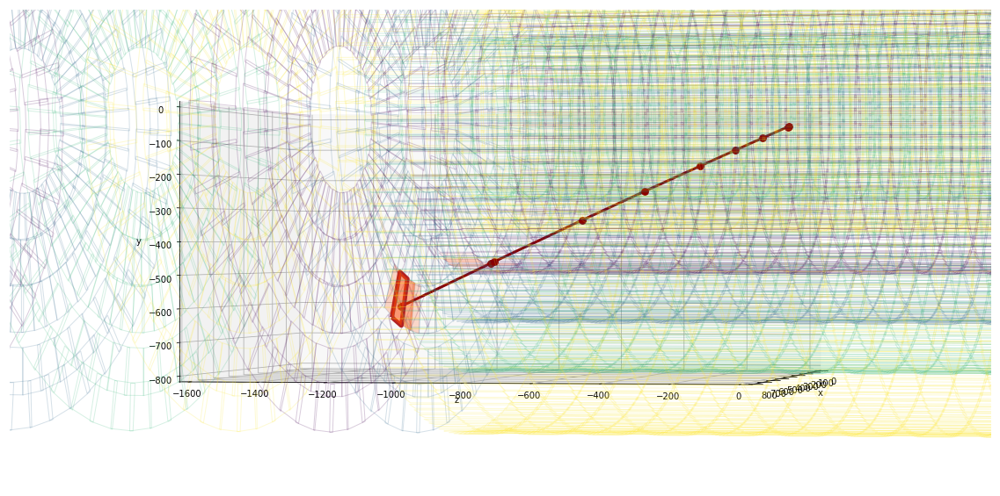

Prediction for hit no. 11:


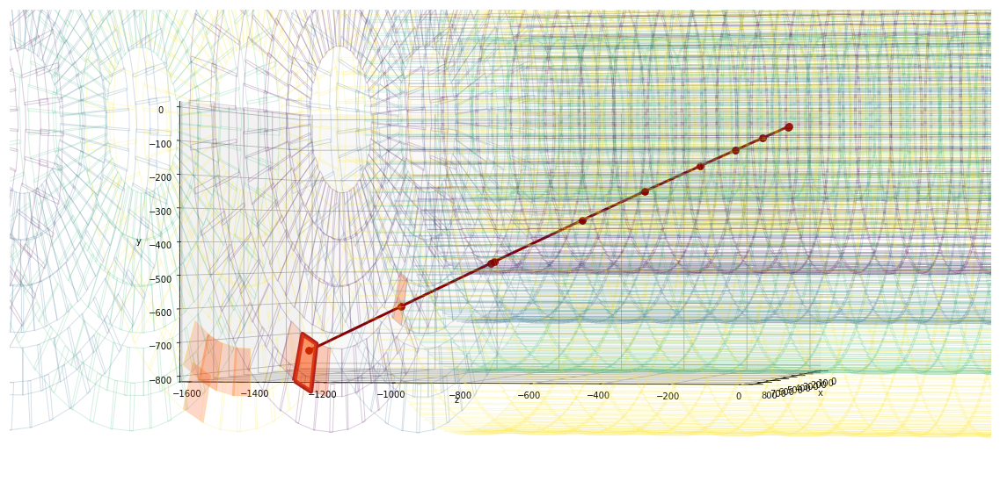

Prediction for hit no. 12:


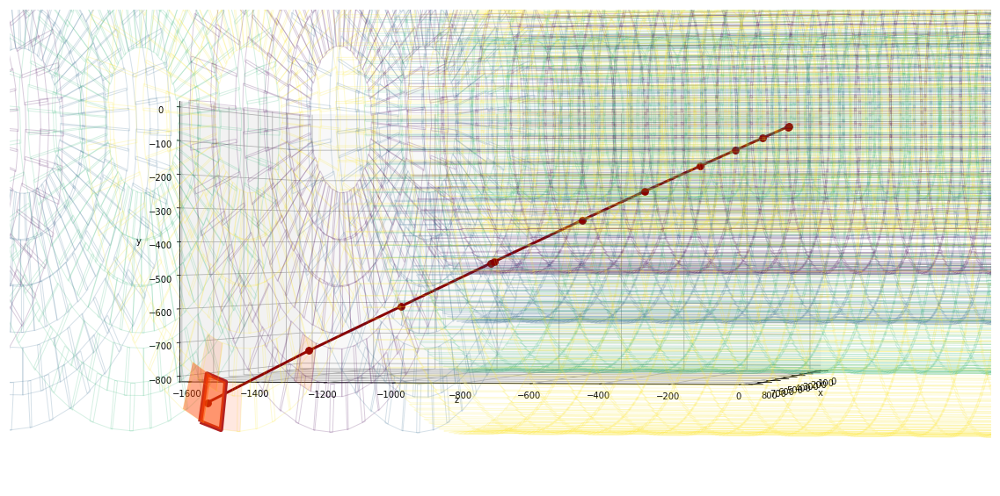

In [16]:
for hit in range(10,13):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,13,14,16,17,18], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
    ax.set_xlim([0,800])
    ax.set_zlim([-800,0])
    ax.set_ylim([-1600,0])
    ax.view_init(0, 10)
    plt.show()

##### Commentary:

Exemplary performance on all the final hits. I found it interesting that for hit 11, it noticed some probability for the particle to go through the gap between the two ring volumes and skip a layer.

## Now let's look at some of the failing predictions

Get the top 10 predictions for every hit in the track.

In [40]:
x, y_true, lengths, weights = mh.get_entire_event_for_NN_eval()

In [41]:
track_id_list = mh.track_unique_ids.copy()

# Sort by track length
perms = np.argsort(lengths)
lengths = lengths[perms]
x = x[perms]
y_true = y_true[perms]
weights = weights[perms]
track_id_list = track_id_list[perms]

# Remove tracks with less than four hits
numdrop = np.searchsorted(lengths, 4)
lengths = lengths[numdrop:]
x = x[numdrop:]
y_true = y_true[numdrop:]
weights = weights[numdrop:]
track_id_list = track_id_list[numdrop:]

Find the tracks where the correct answer for the 10th hit is not even in the top 100 predictions.

In [42]:
y_pred = model.predict(x)

nhit = 10
first_track_no = np.searchsorted(lengths, nhit-1, side='right')

fail_tracks = list_k_fails(y_true[first_track_no:,nhit-2], y_pred[first_track_no:,nhit-2], track_id_list[first_track_no:], k=100)

In [160]:
print("Shit fraction =",1.*len(fail_tracks) / len(track_id_list[first_track_no:]))

Shit fraction = 0.0384779213403


## Shit Hit 0

In [146]:
track_id = fail_tracks[0]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 8:


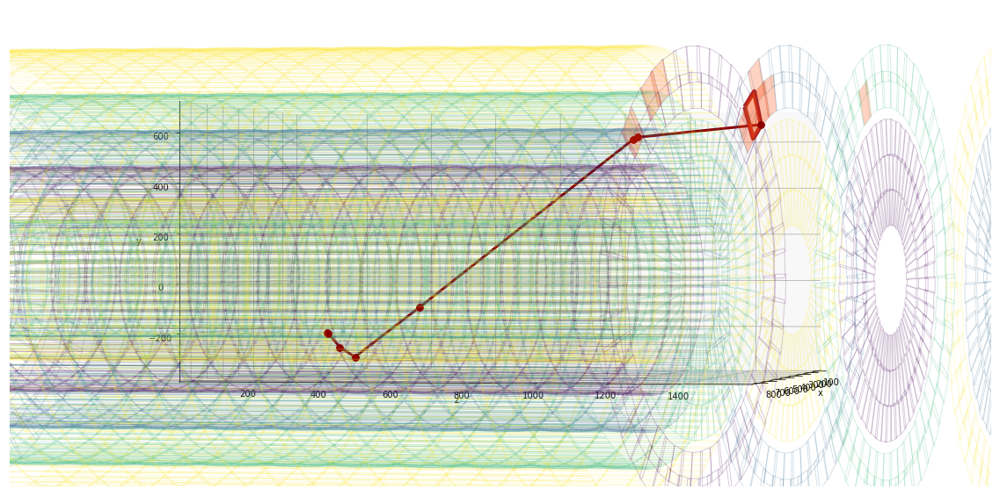

Prediction for hit no. 9:


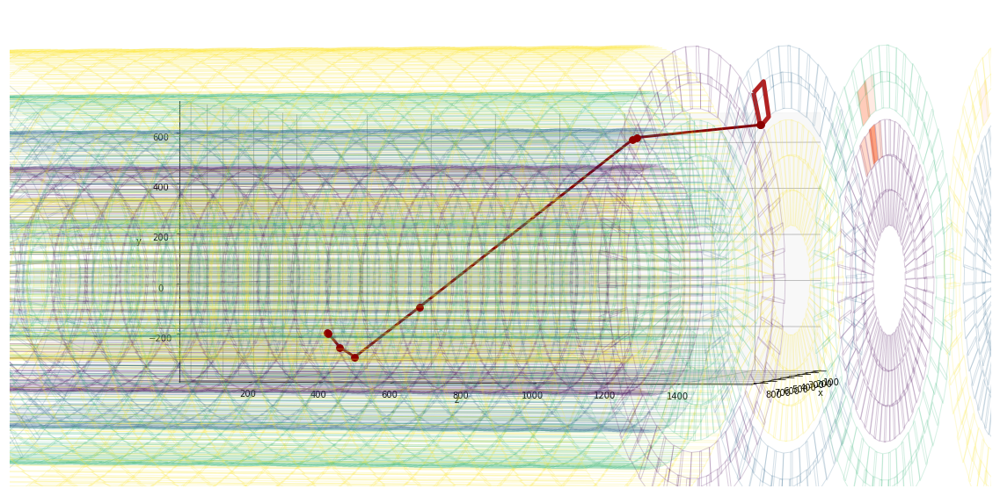

Prediction for hit no. 10:


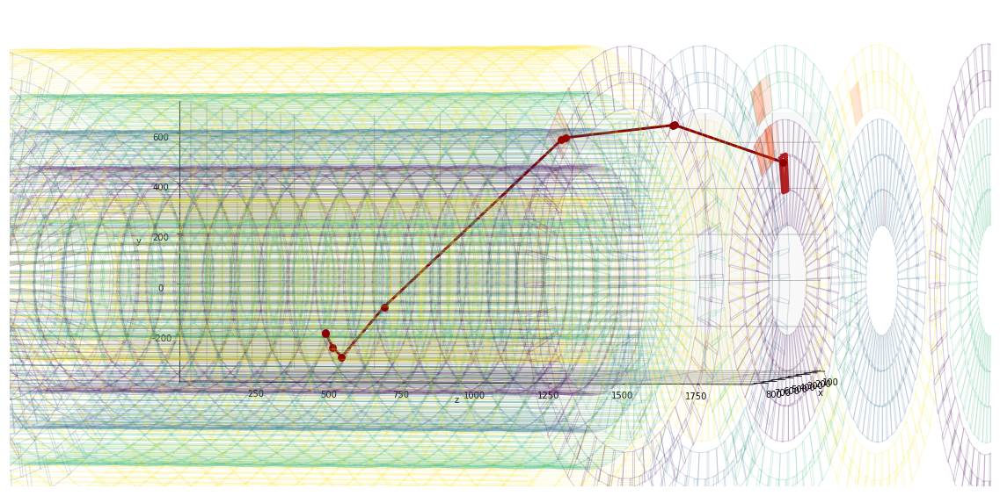

In [52]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,13,14,16,17,18], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
#     ax.set_xlim([0,800])
#     ax.set_zlim([-800,0])
#     ax.set_ylim([-1600,0])
    ax.view_init(0, 10)
    plt.show()

##### Commentary

It is not obvious in the above, but that last hit was not among the predicted. This is an unusual track in that it doesn't start in the middle of the detector: it starts on the fifth layer or so. Let's get a clearer view with 2D projections:

Prediction for hit no. 8:


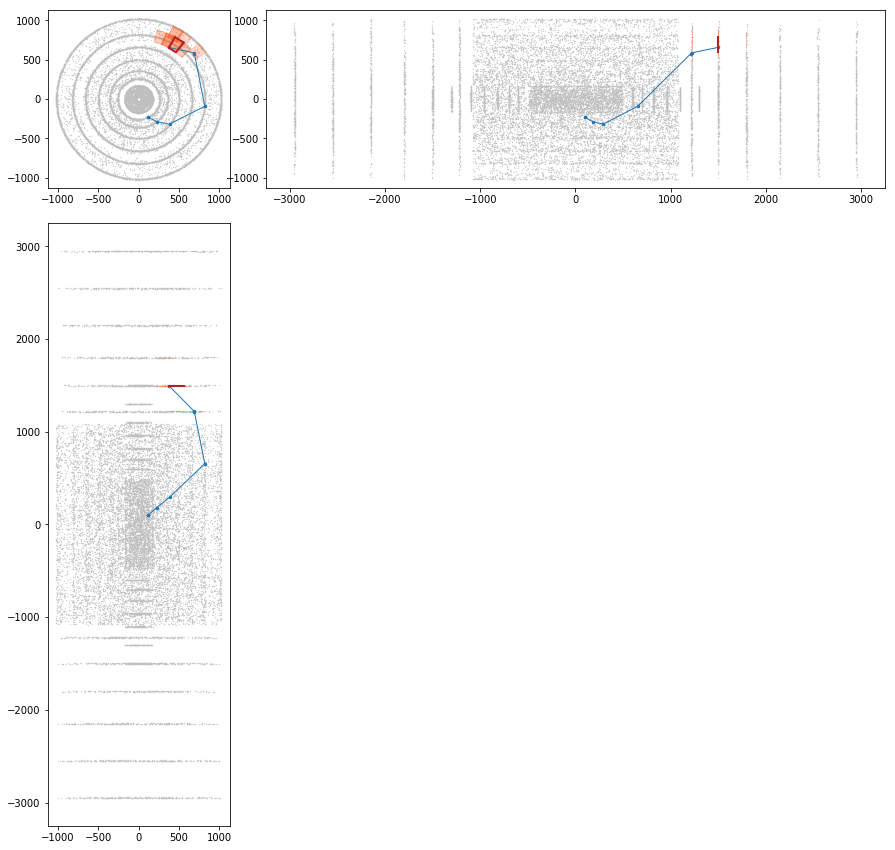

Prediction for hit no. 9:


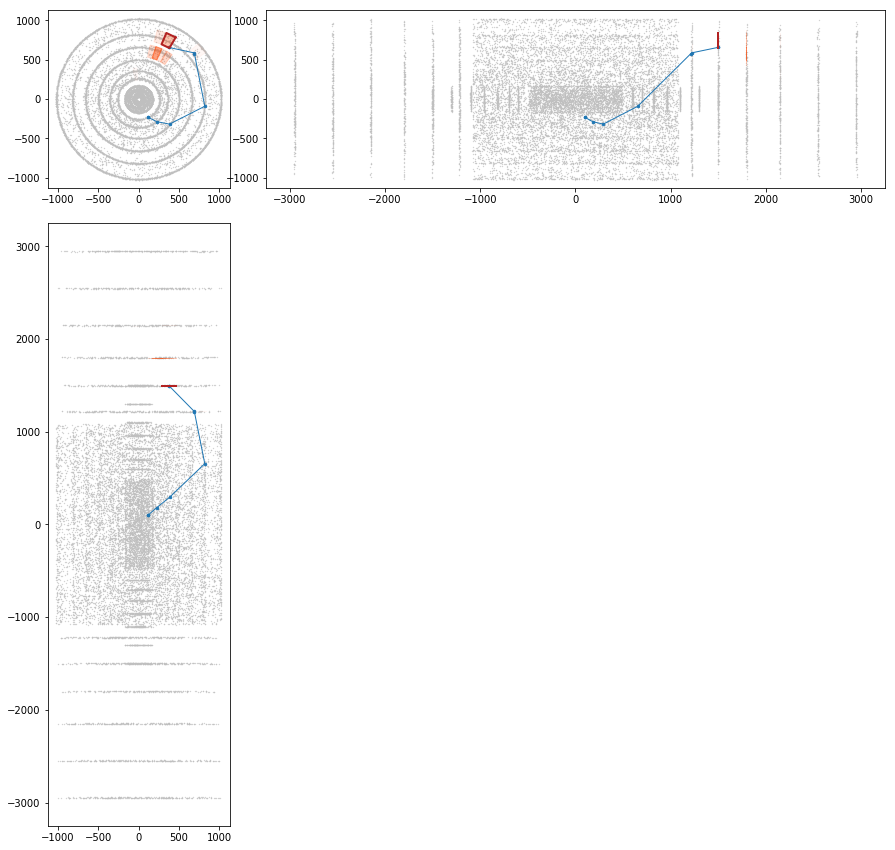

Prediction for hit no. 10:


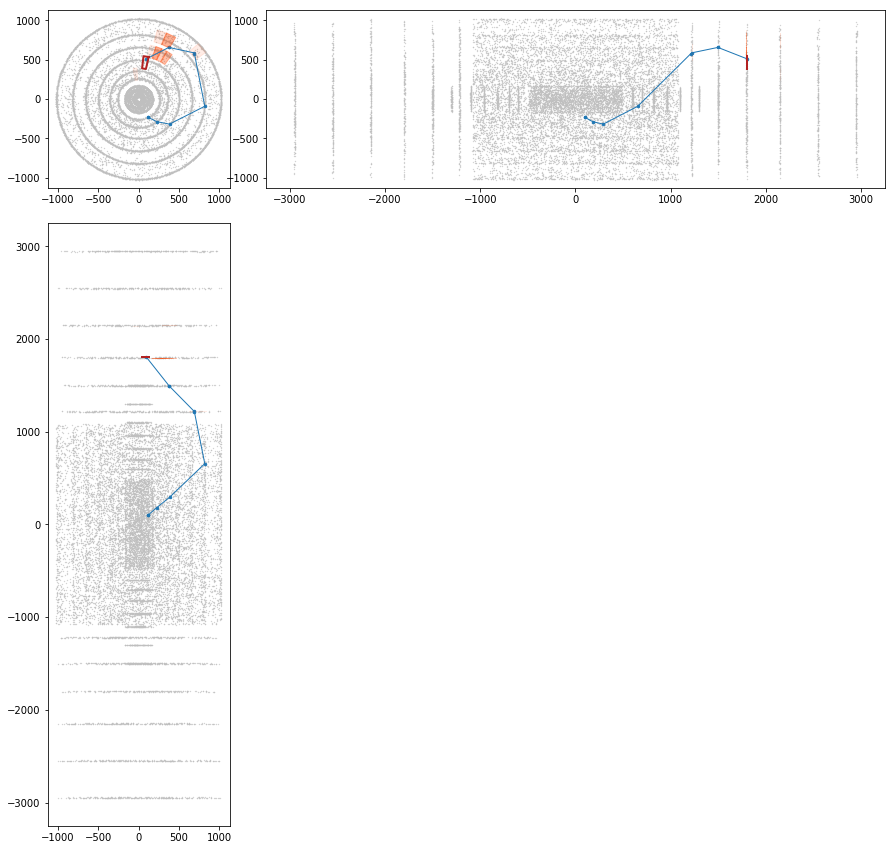

In [147]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)

    plt.show()

##### Commentary:

The track is quite curvy and low momentum. Still, the last hit seems to be on the correct circle in the xy plane. It looks like one that, while difficult, should be in the top-100 predictions.

## Shit Hit 1

In [56]:
track_id = fail_tracks[1]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 8:


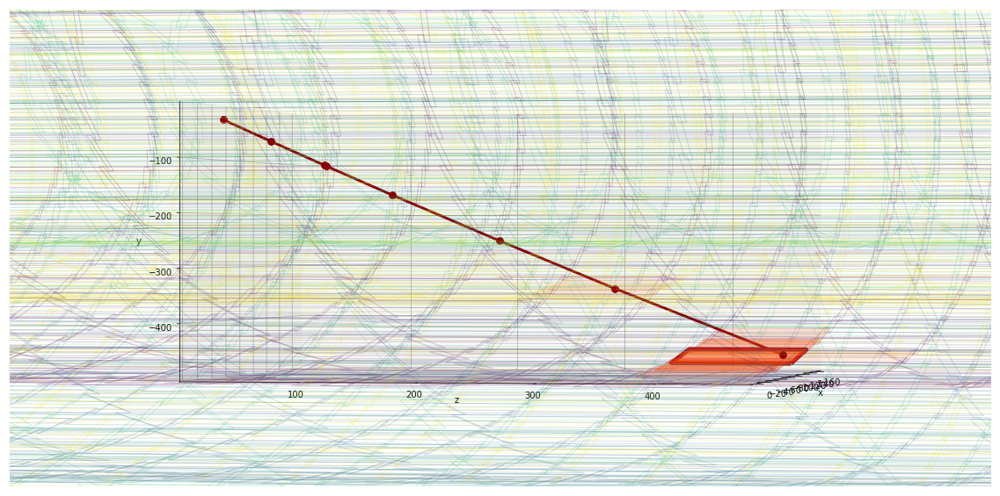

Prediction for hit no. 9:


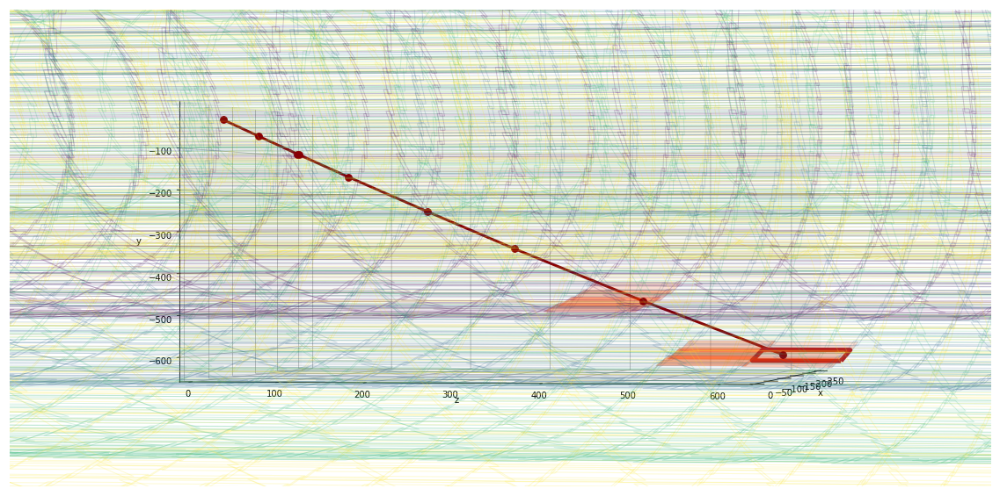

Prediction for hit no. 10:


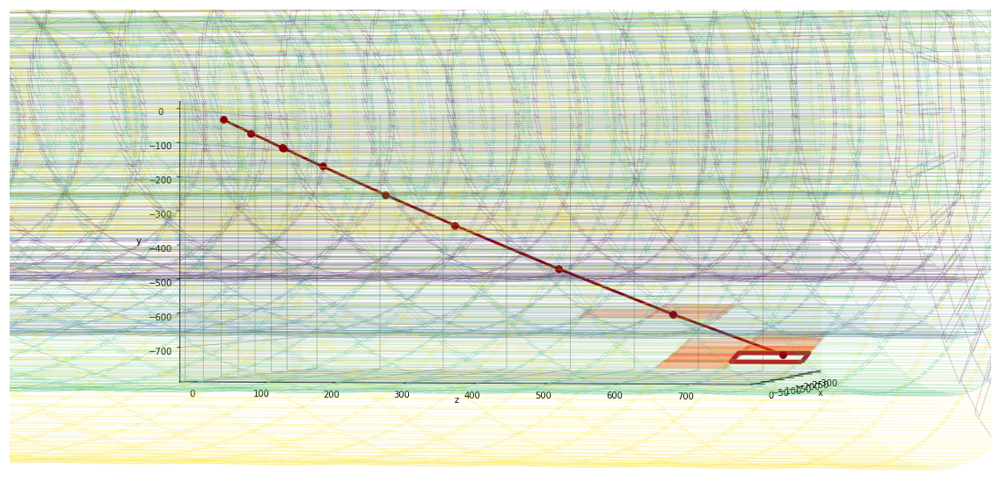

In [58]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,13,14,16,17,18], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
#     ax.set_xlim([0,800])
#     ax.set_zlim([-800,0])
#     ax.set_ylim([-1600,0])
    ax.view_init(0, 10)
    plt.show()

Prediction for hit no. 8:


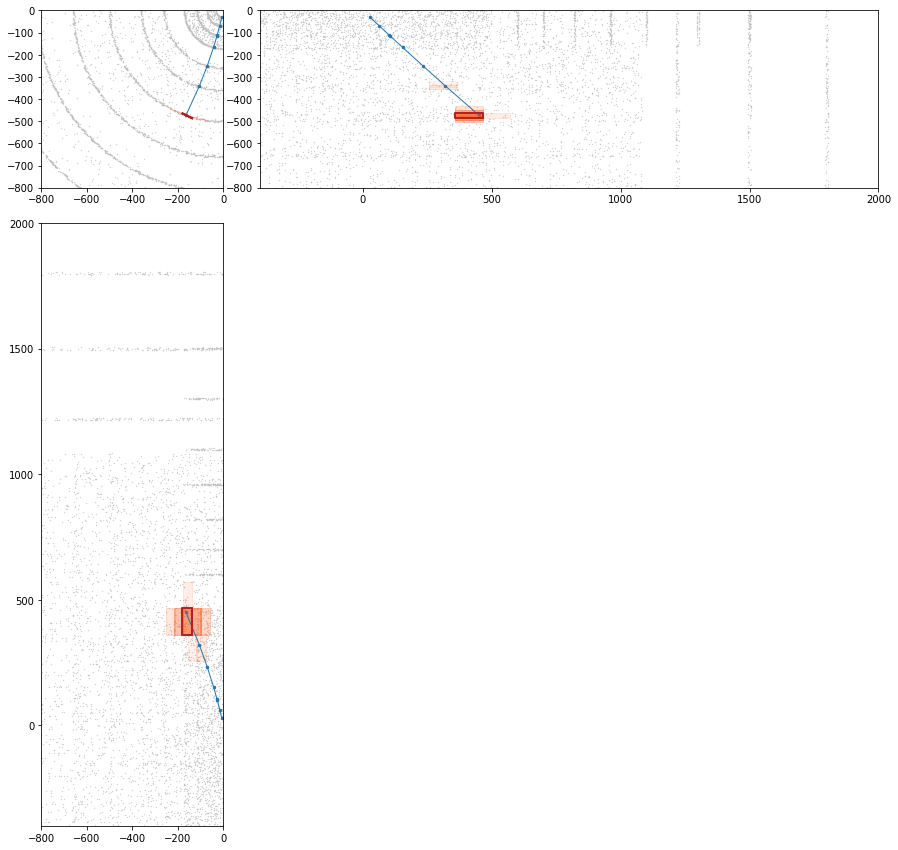

Prediction for hit no. 9:


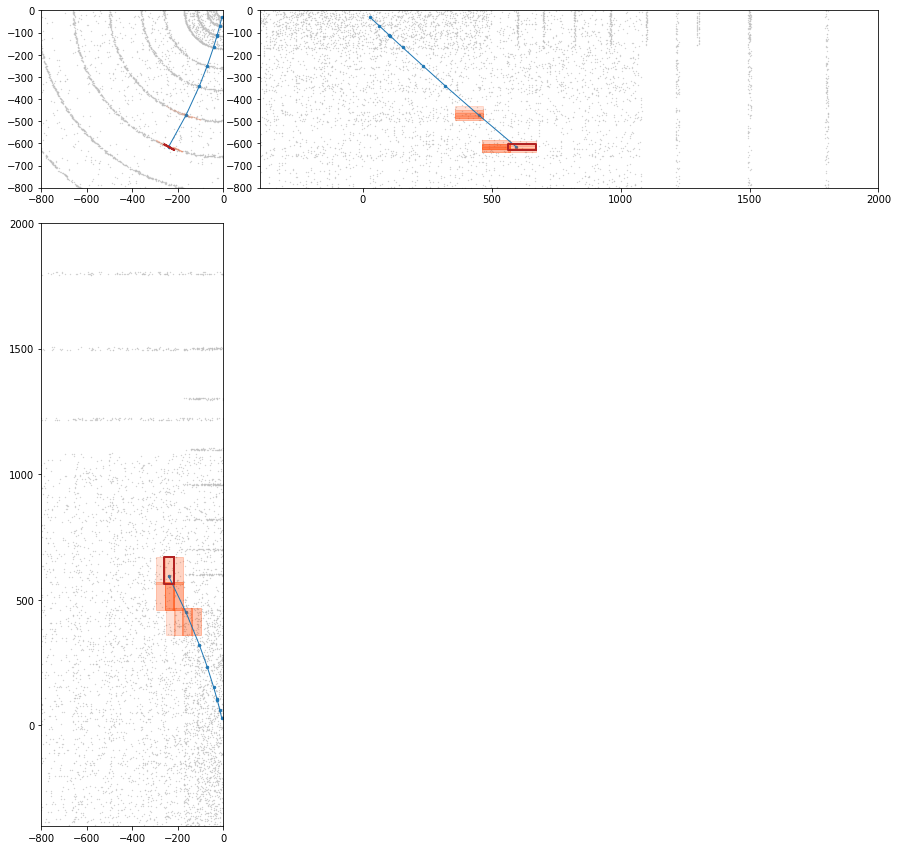

Prediction for hit no. 10:


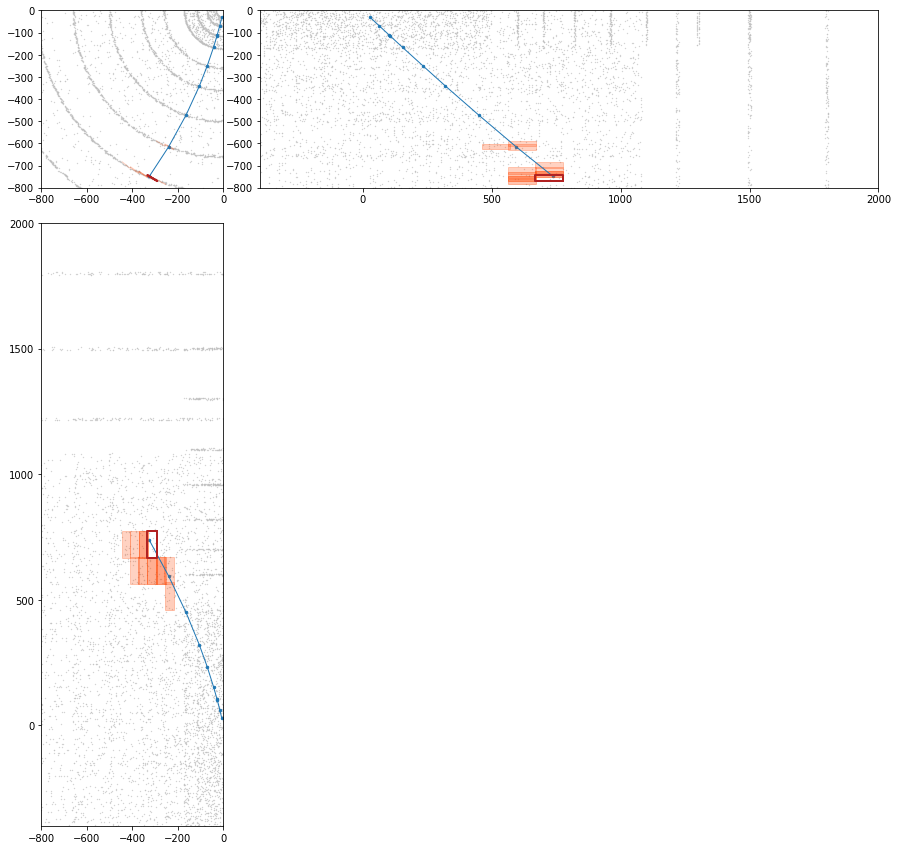

In [61]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -800, 0, -800, 0, -400, 2000)
    plt.show()

##### Commentary:

This is a nice, straight track. There is no excuse for the correct module not lighting up. A lot of nearby ones did. It seems like it incorrectly calculated the trajectory of this track.

## Shit Hit 2

In [62]:
track_id = fail_tracks[2]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 9:


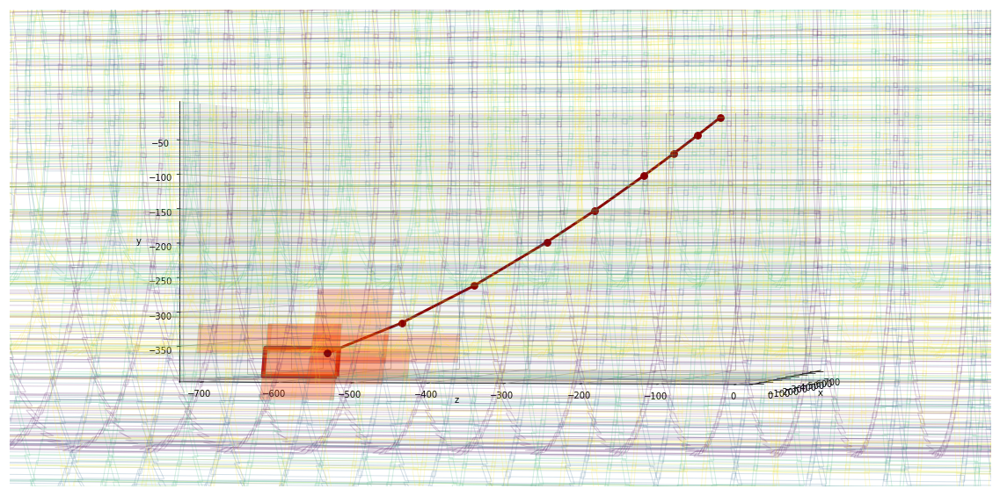

Prediction for hit no. 10:


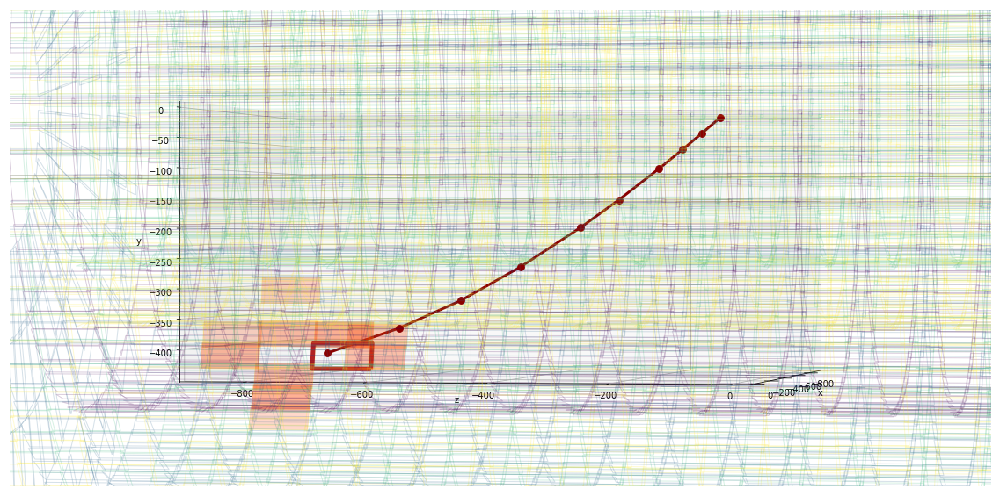

In [65]:
for hit in range(9,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,13,14,16,17,18], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
#     ax.set_xlim([0,800])
#     ax.set_zlim([-800,0])
#     ax.set_ylim([-1600,0])
    ax.view_init(0, 10)
    plt.show()

Prediction for hit no. 9:


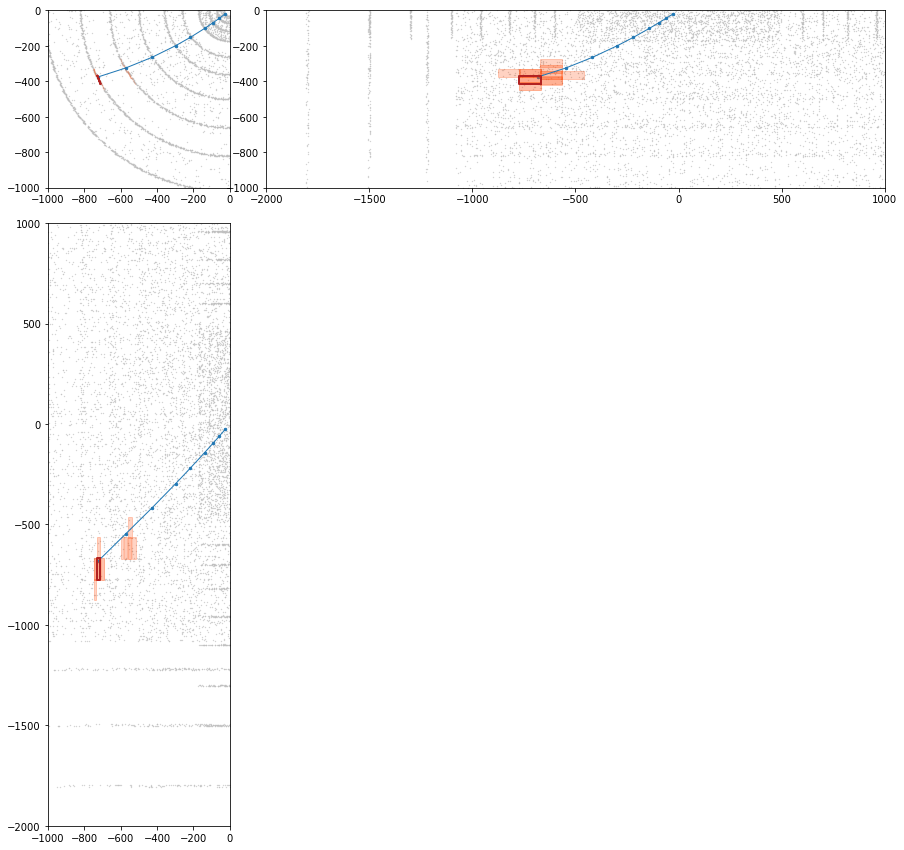

Prediction for hit no. 10:


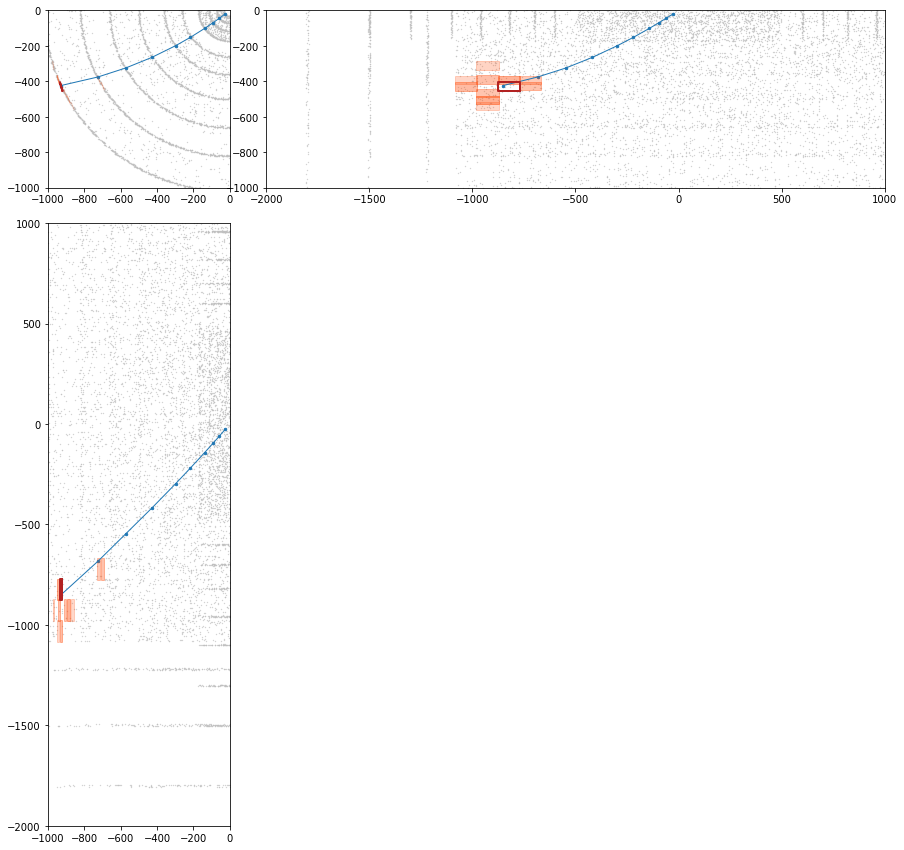

In [66]:
for hit in range(9,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -1000, 0, -1000, 0, -2000, 1000)
    plt.show()

##### Commentary:

Again, no excuse. Again, a lot of nearby modules are lighting up. A hypothesis is forming that in these failed cases, the hit is occuring in a module that happens to not have had many training examples. It makes sense that this would affect more the outer layers, since the hits are much sparser in those layers.

## Shit Hit 3

In [149]:
track_id = fail_tracks[3]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 9:


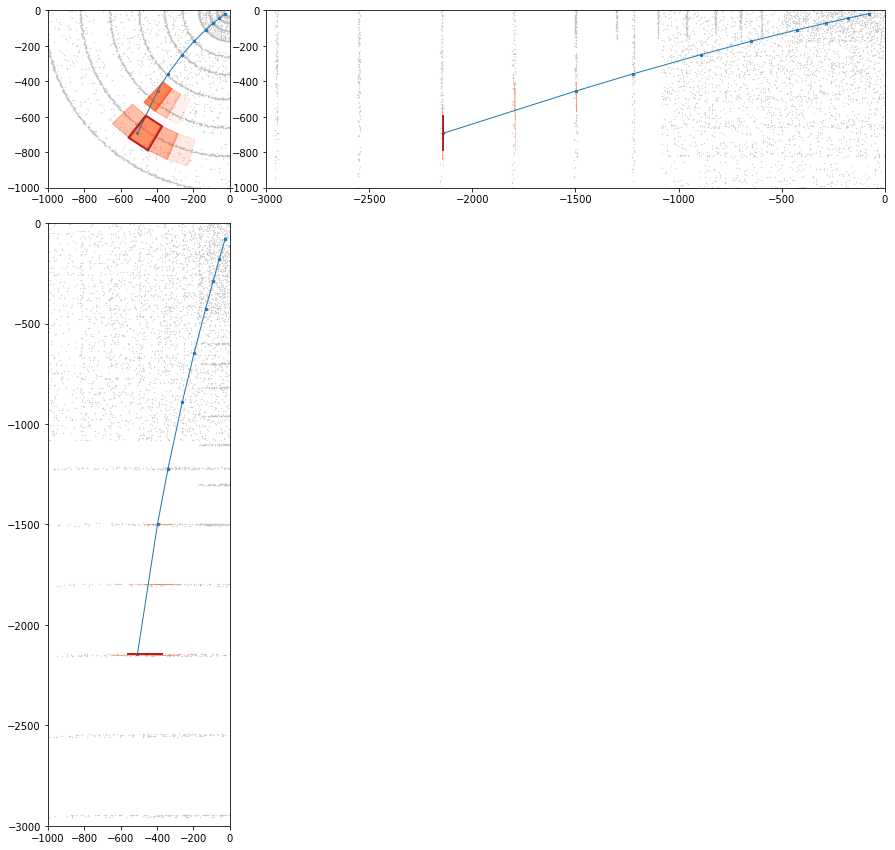

Prediction for hit no. 10:


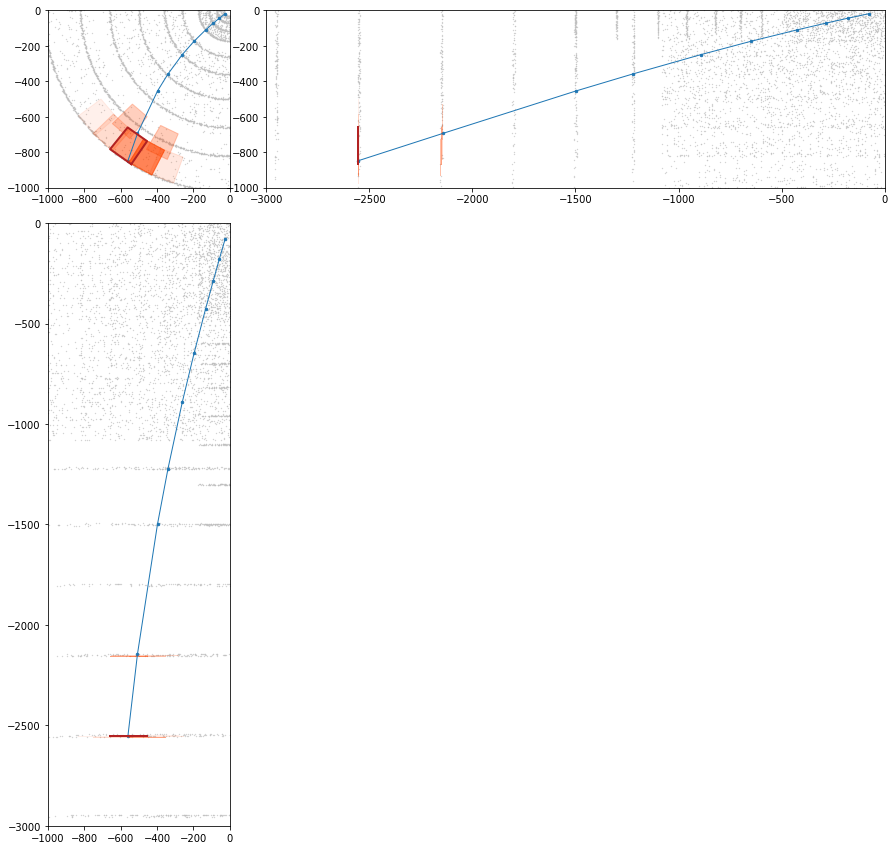

In [70]:
for hit in range(9,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -1000, 0, -1000, 0, -3000, 0)
    plt.show()

##### Commentary:

In the above it looks like the hit was correctly predicted. It is merely a trick of the light, as illustrated below.

Prediction for hit no. 9:


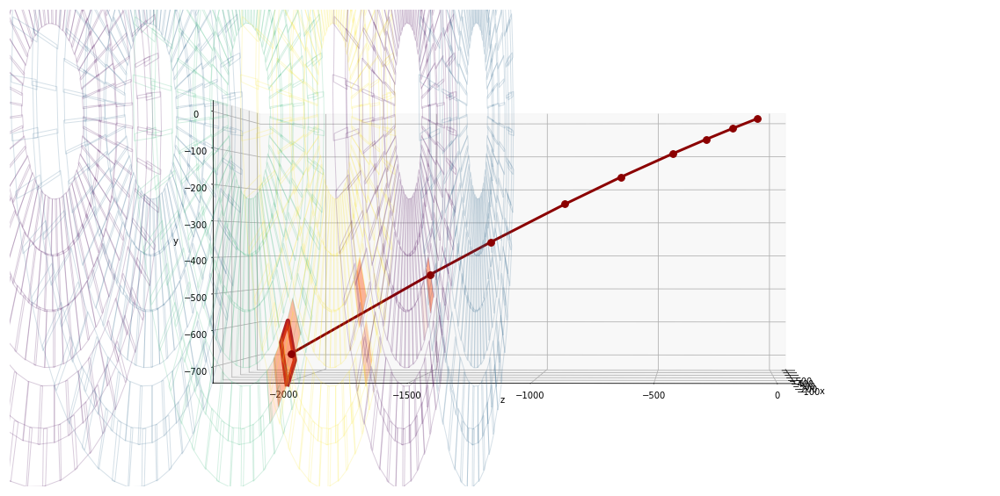

Prediction for hit no. 10:


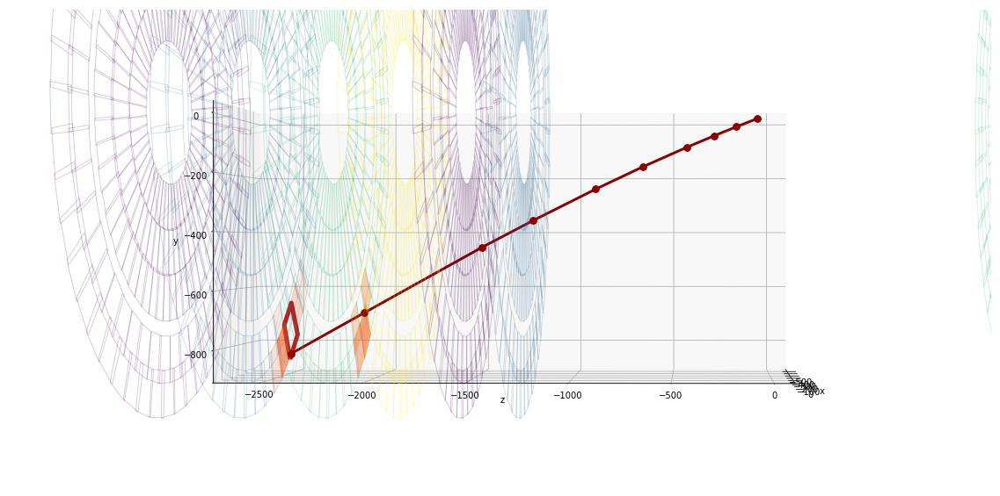

In [150]:
for hit in range(9,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,14,16,18], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
#     ax.set_xlim([0,800])
#     ax.set_zlim([-800,0])
#     ax.set_ylim([-1600,0])
    ax.view_init(0, 2)
    plt.show()

##### Commentary

I think that it predicted that if it was on a trajectory that would ultimately take it to the hit module, it would first have to double-hit in the previous layer. We see that the prediction is that it will either a) double hit either to the right, left, or below, or it will go through to the next layer and hit the module to the left of the actual hit module.

## Shit Hit 4

In [81]:
track_id = fail_tracks[4]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 9:


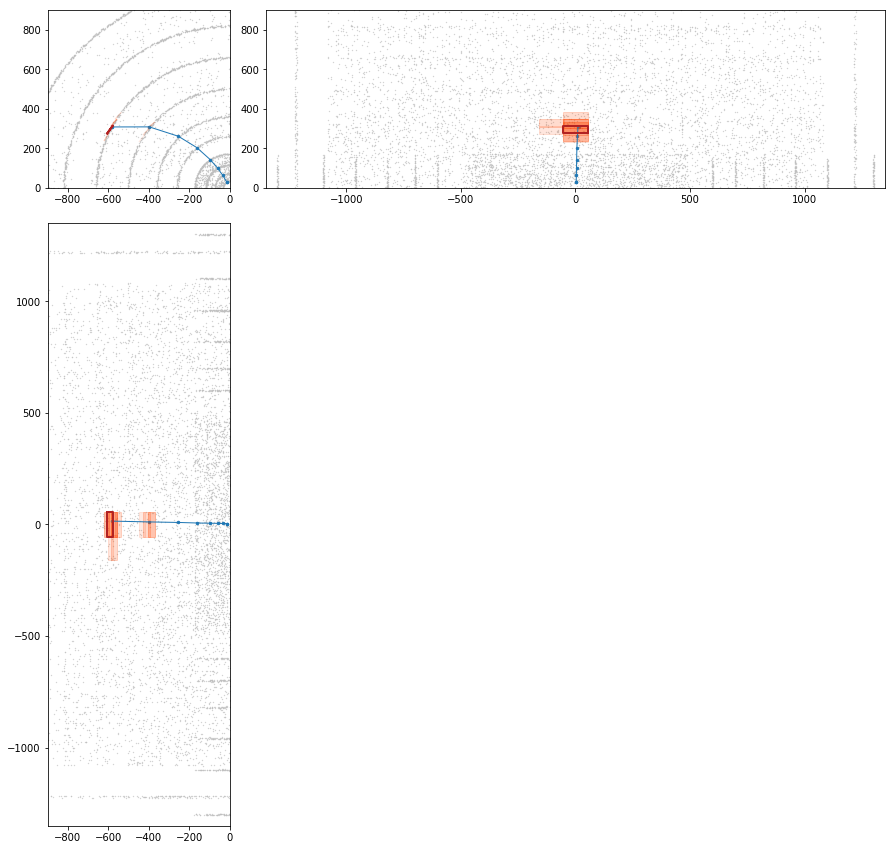

Prediction for hit no. 10:


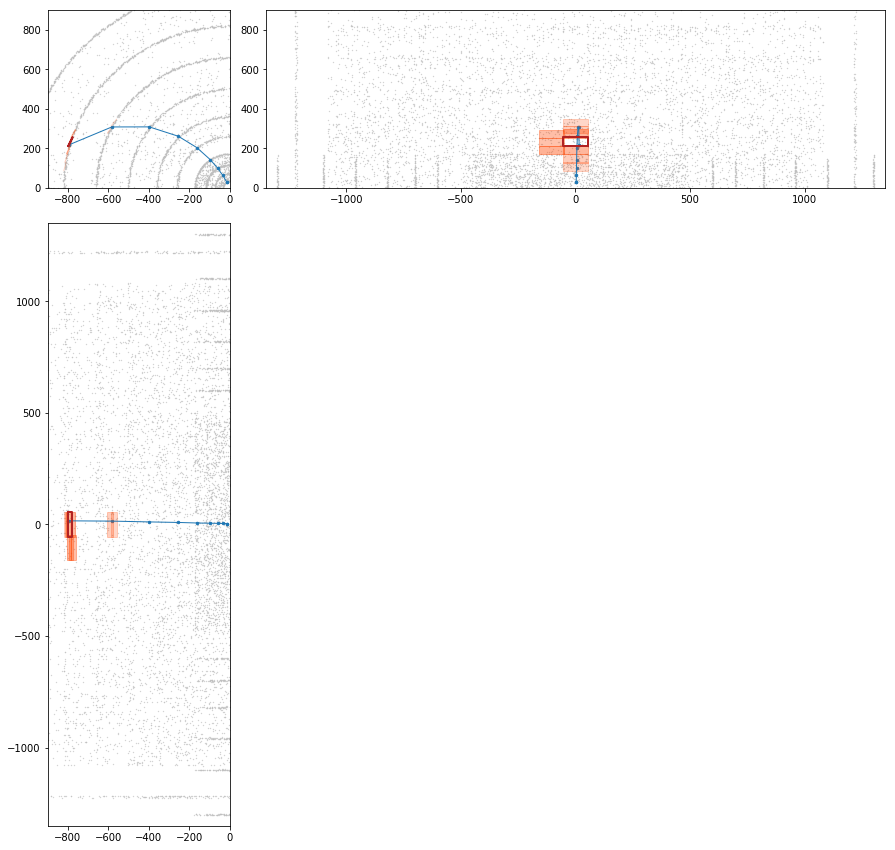

In [85]:
for hit in range(9,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -900, 0, 0, 900, -1350, 1350)
    plt.show()

##### Commentary

Absolutely no excuse. It was a very nice track. A lot of nearby modules lit up, just not this one.

## Shit hit 5

In [152]:
track_id = fail_tracks[5]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 9:


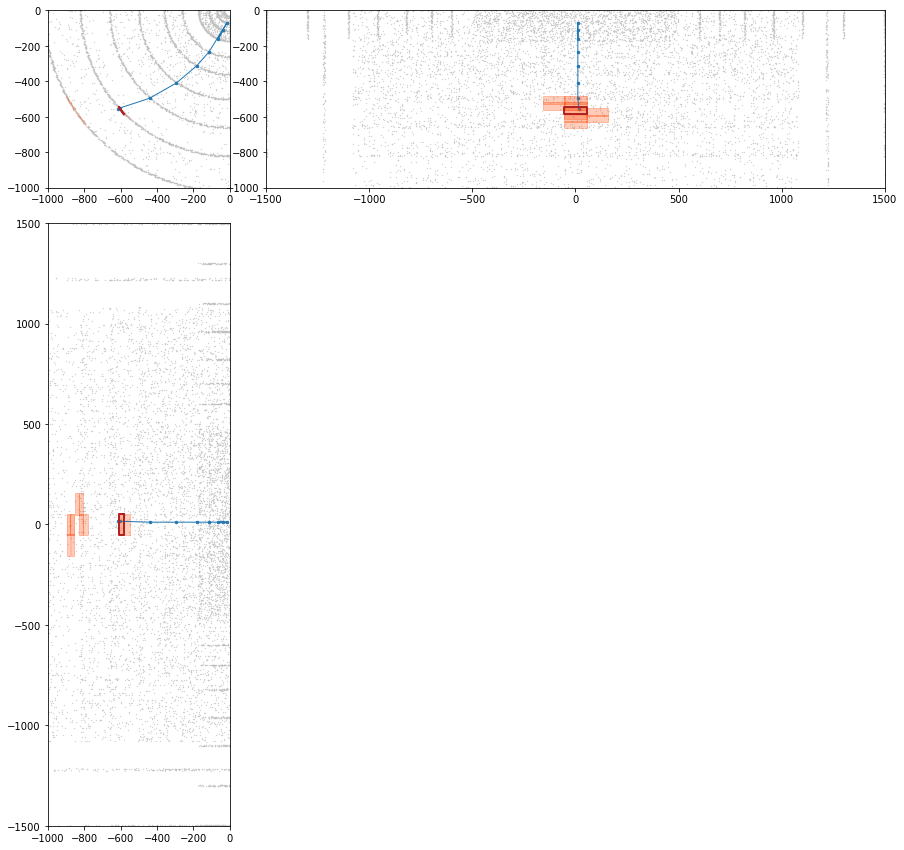

Prediction for hit no. 10:


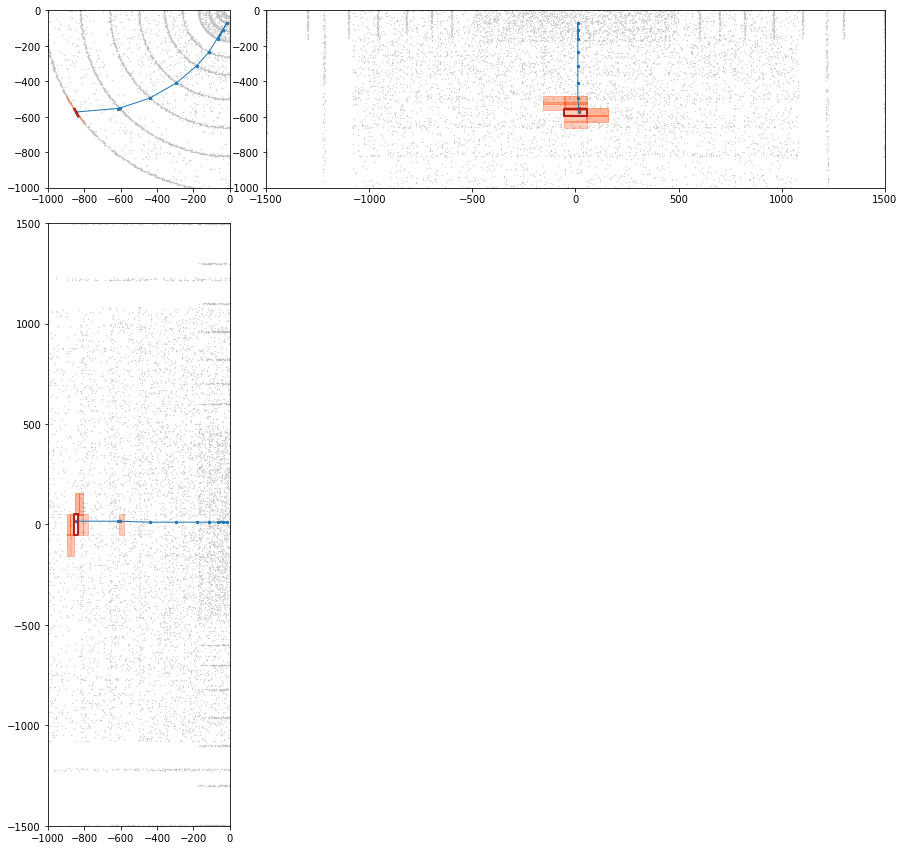

In [89]:
for hit in range(9,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -1000, 0, -1000, 0, -1500, 1500)
    plt.show()

##### Commentary:

Pathetic.

Prediction for hit no. 10:


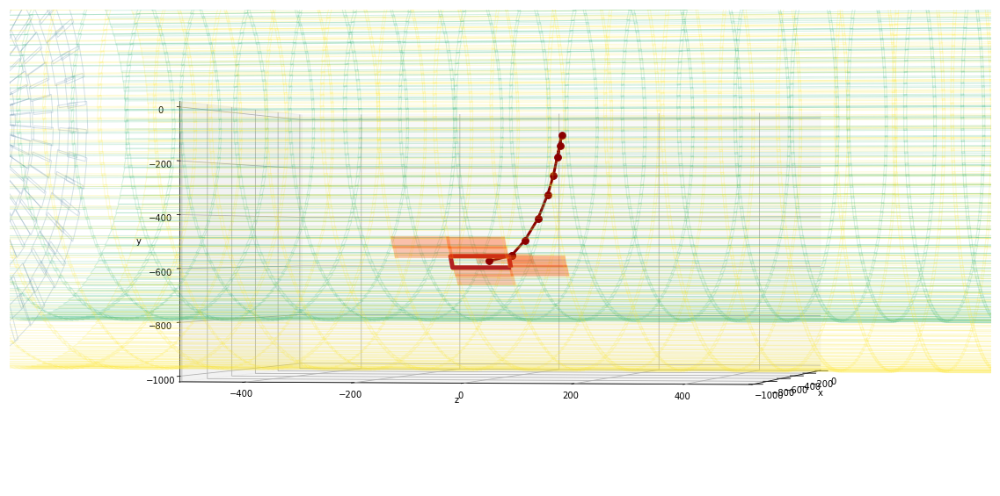

In [153]:
for hit in range(10,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_3D_plot(track_id, volumes = [12,14,16,17,18], hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_3D_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_3D_plot(fig, module_ids[hit_index-1], alphas)
    ax.set_xlim([0,-1000])
    ax.set_zlim([-1000,0])
    ax.set_ylim([-500,500])
    ax.view_init(0, 10)
    plt.show()

## Shit Hit 6

In [118]:
track_id = fail_tracks[6]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 8:


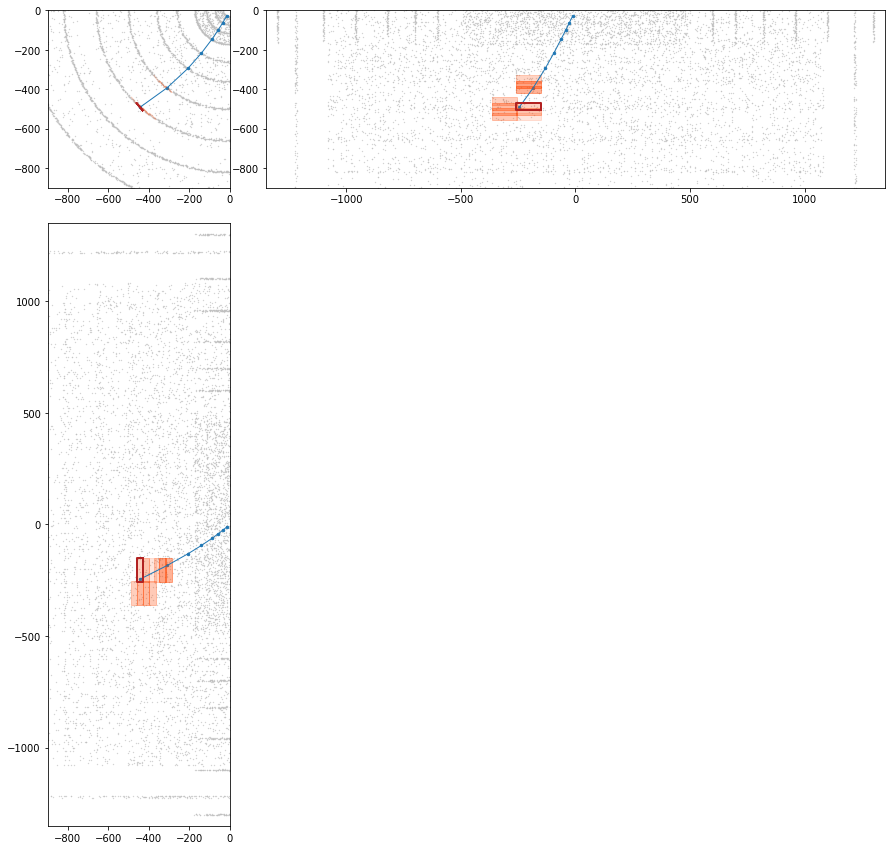

Prediction for hit no. 9:


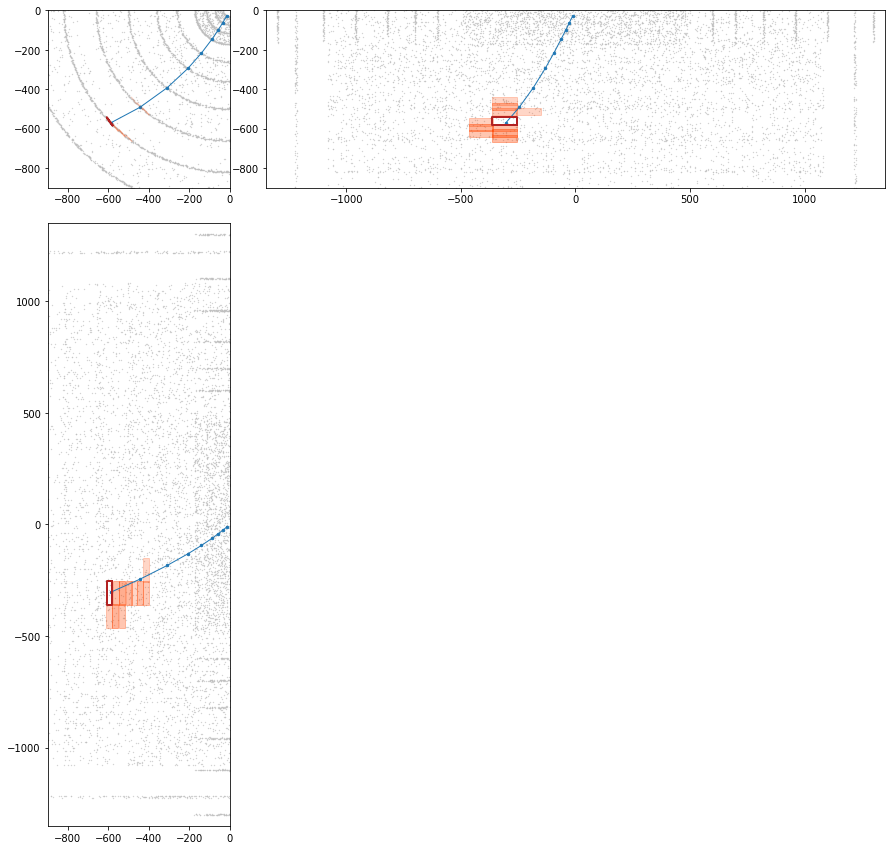

Prediction for hit no. 10:


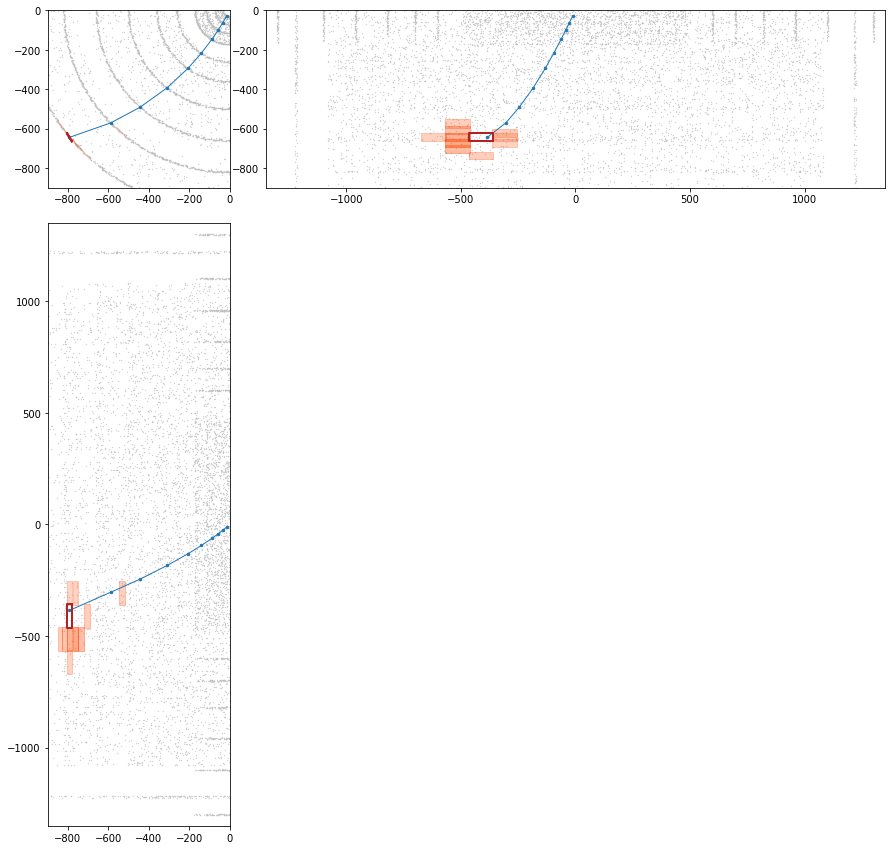

In [121]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], #volumes = [12,13,14,16,17,18],
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -900, 0, -900, 0, -1350, 1350)
    plt.show()

##### Commentary

It gets both 9 and 10 wrong. The NN seems to think this track is moving straighter than it actually is. I get the impression from the xy projection that the particle may have lost some energy along the way, and the radius of curvature is decreasing a little bit later on. Still, it is not so dramatic and I feel this is one that the NN should get right.

## Shit hit 7

In [154]:
track_id = fail_tracks[7]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 8:


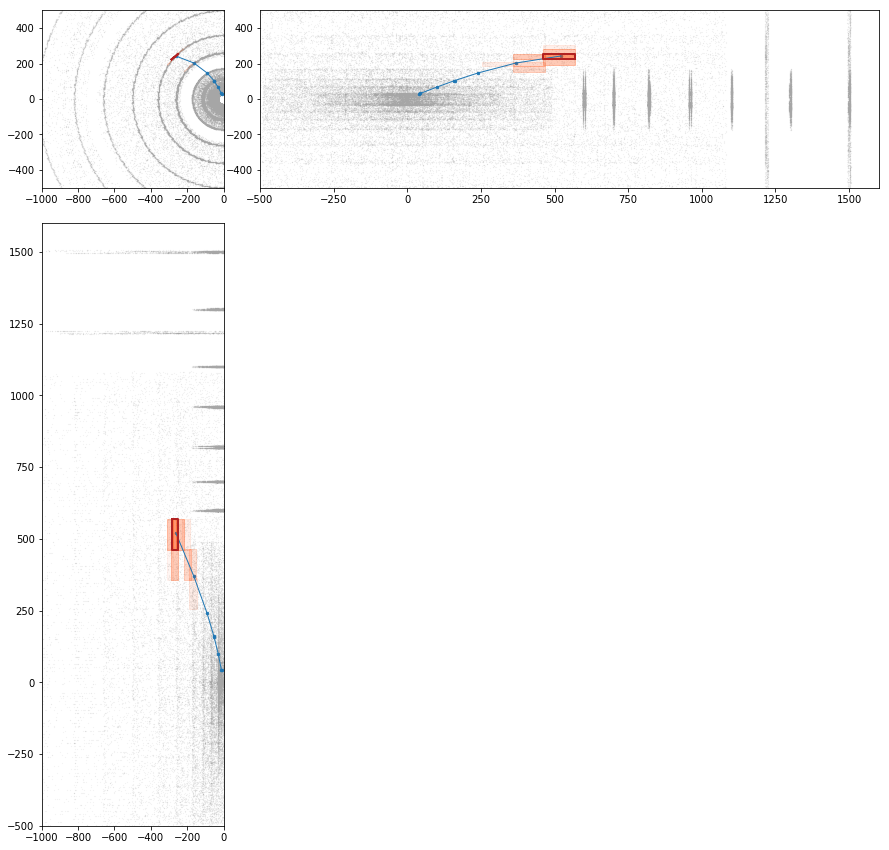

Prediction for hit no. 9:


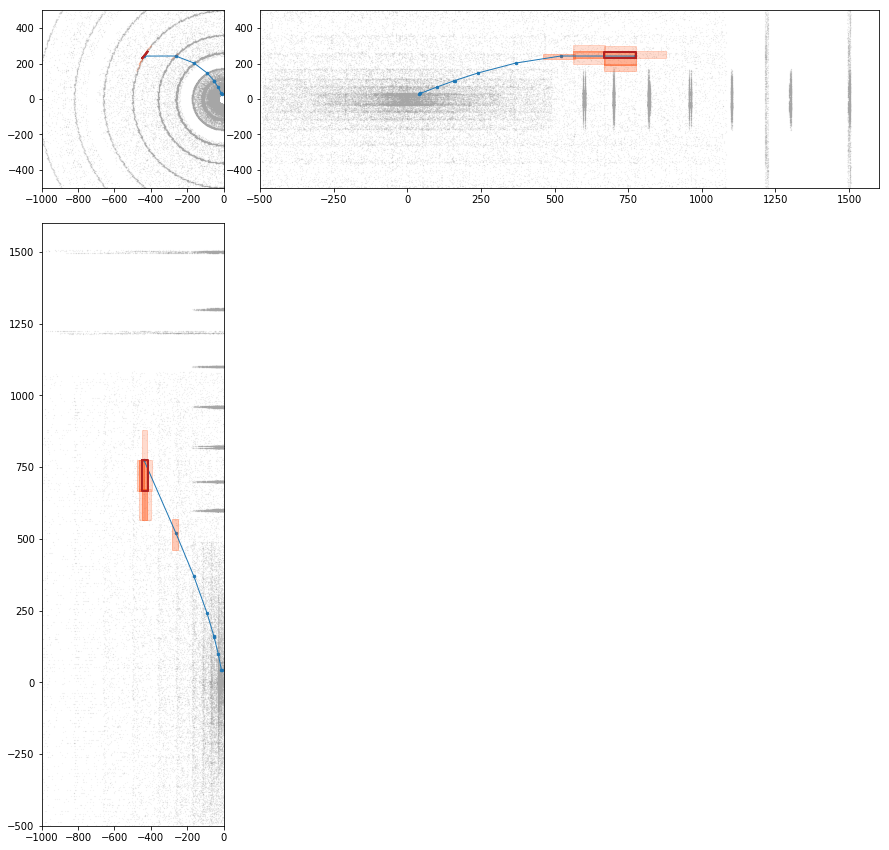

Prediction for hit no. 10:


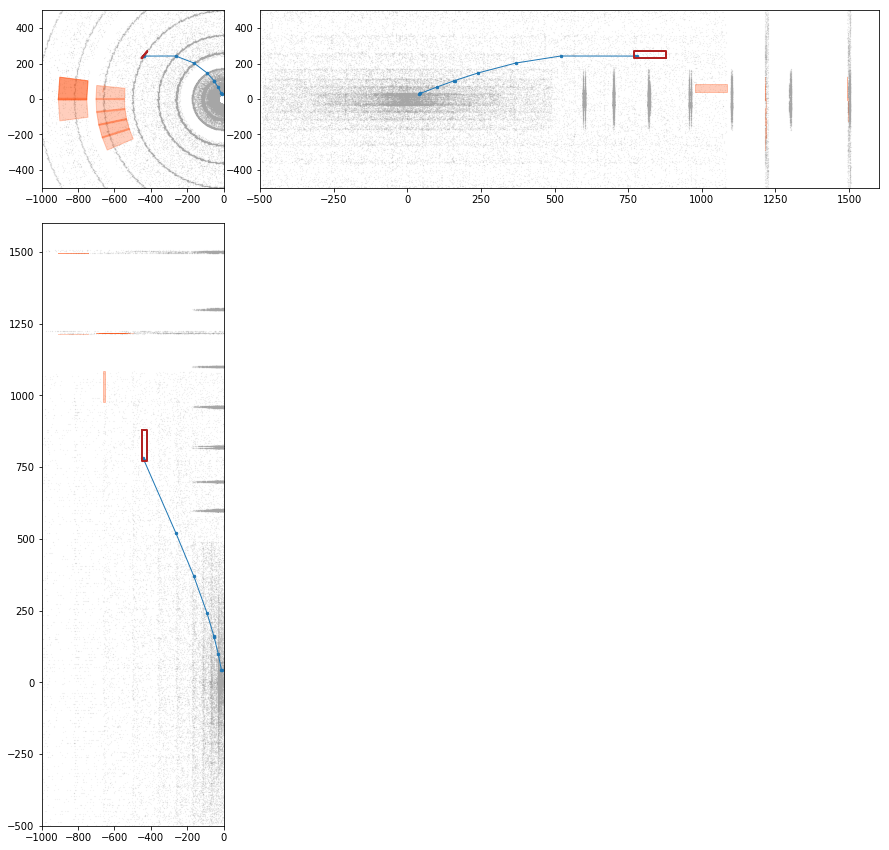

In [156]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], bg_style = 'all_hits',
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -1000, 0, -500, 500, -500, 1600)
    plt.show()

##### Commentary

This was a double hit that the NN failed to see. It did plot a reasonable trajectory of the track's future. The double hit was coming in at quite a shallow angle.

## Shit hit 8

In [133]:
track_id = fail_tracks[8]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 8:


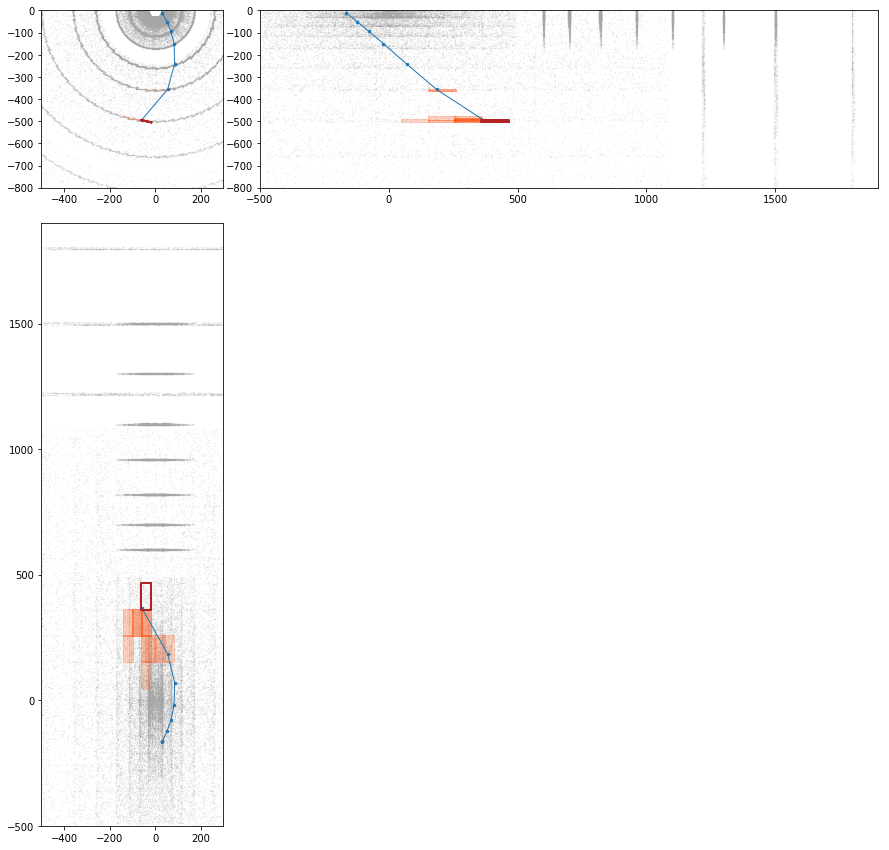

Prediction for hit no. 9:


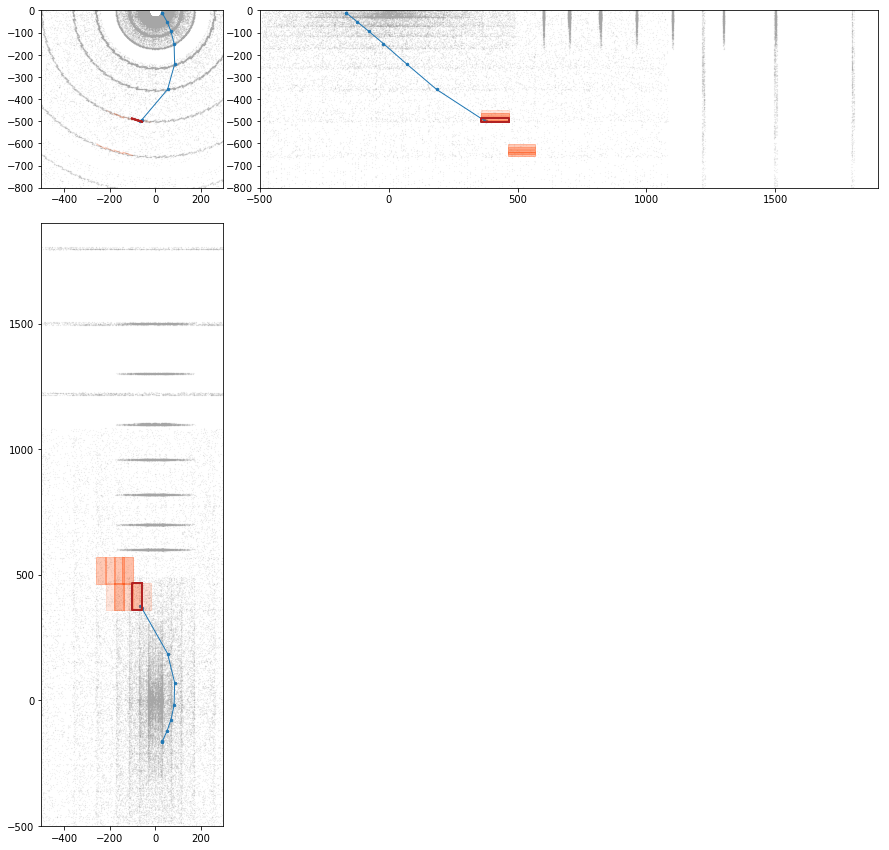

Prediction for hit no. 10:


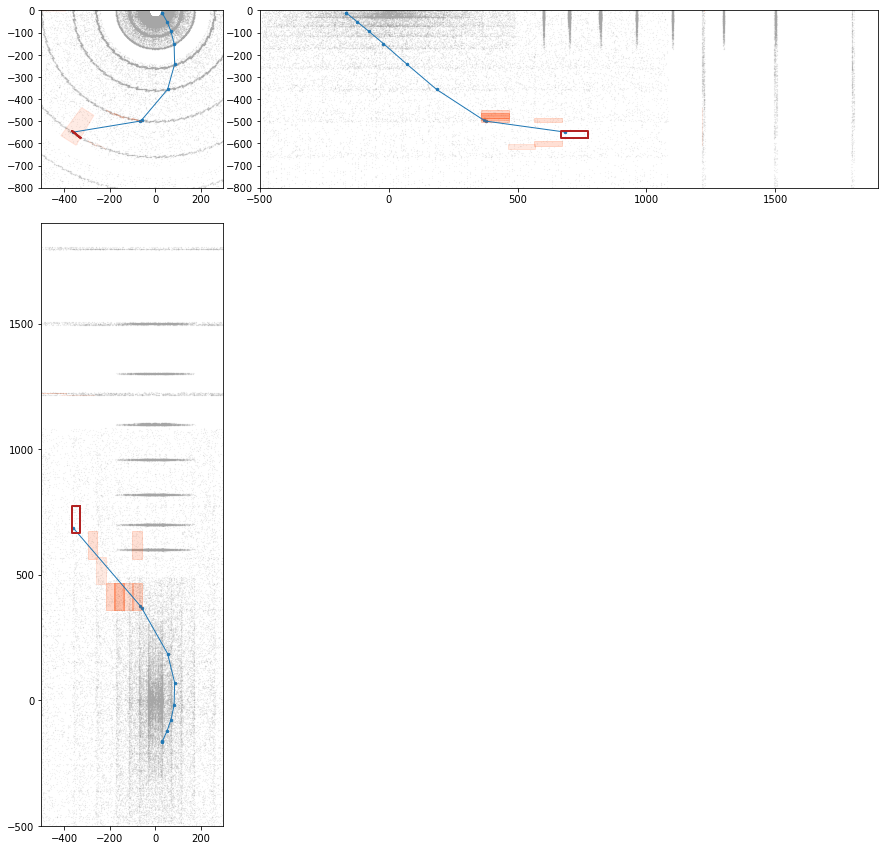

In [137]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], bg_style = 'all_hits',
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -500, 300, -800, 0, -500, 1900)
    plt.show()

##### Commentary

It thought there would be a double-hit. Most of the proposed hits look reasonable, but the true hit should have been among them. This track originated at relatively large z.

## Shit Hit 9

In [138]:
track_id = fail_tracks[9]

track_hits_coords, hits_xyz, track_mod_onehot = mh.get_track_hit_NNinput_realxyz_coords_and_module(track_id)
predictions = model.predict(np.array([track_hits_coords]))[0]
module_ids, top_predictions = mh.get_top_k_module_id_and_pred(predictions, k=10)

Prediction for hit no. 8:


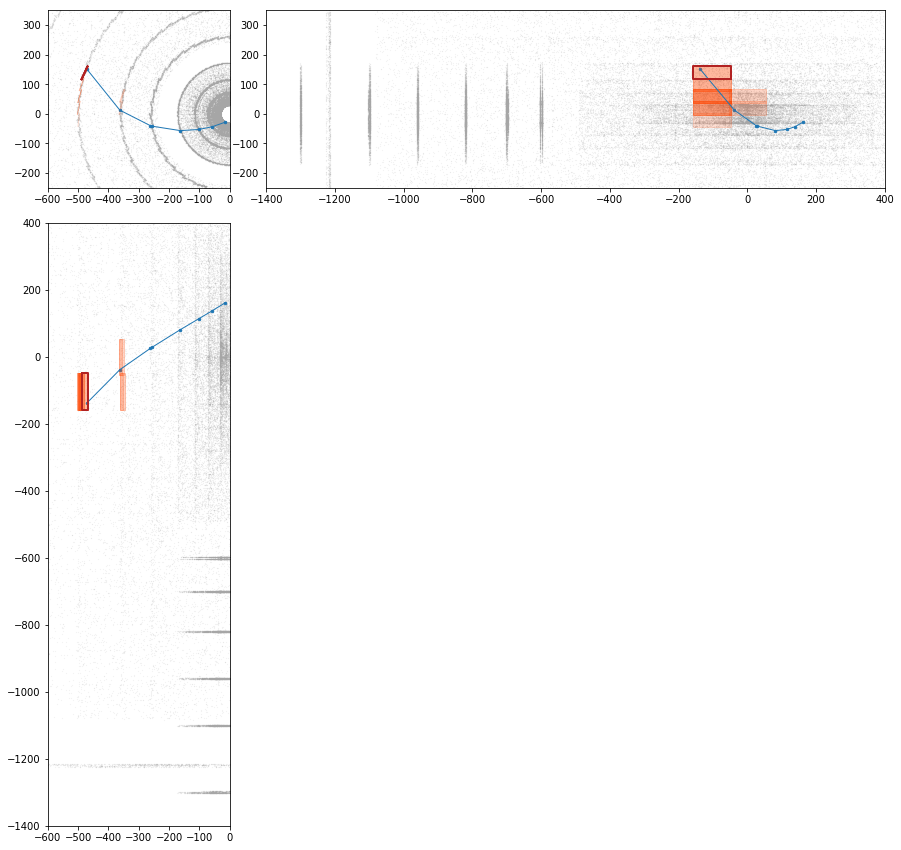

Prediction for hit no. 9:


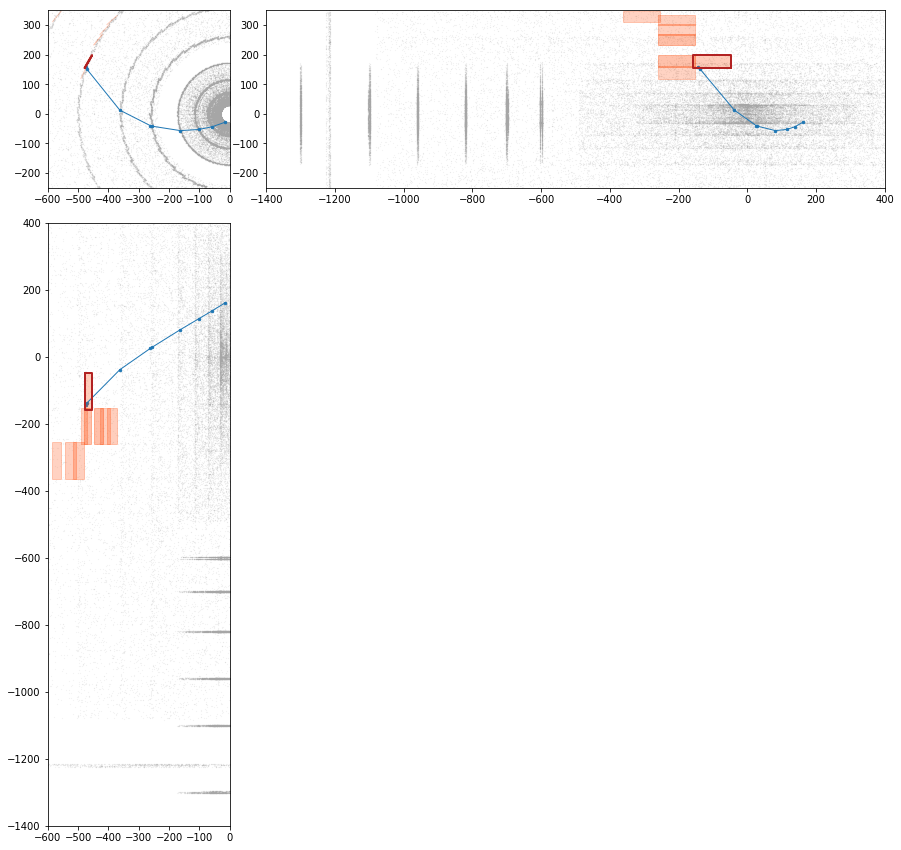

Prediction for hit no. 10:


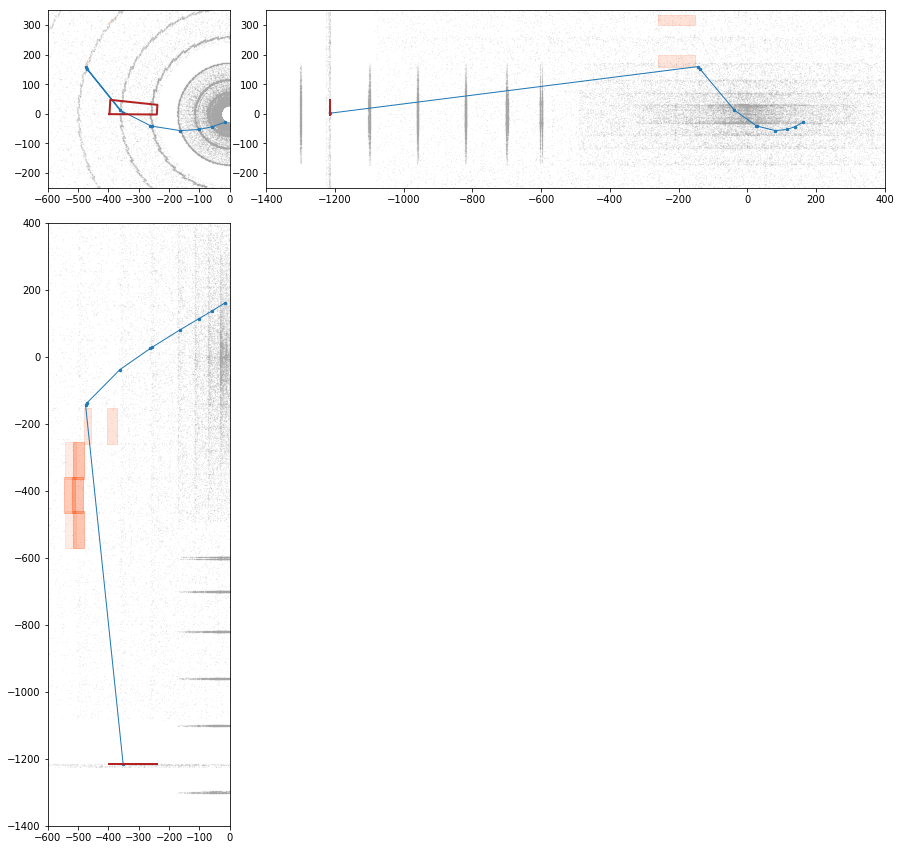

In [144]:
for hit in range(8,11):
    print("Prediction for hit no. " + str(hit) + ":")
    hit_index = hit-1
    alphas = [alphafunc(prediction) for prediction in top_predictions[hit_index-1]]
    fig, ax = myplotter.prepare_2D_projection_plot([track_id], bg_style = 'all_hits',
                                                   hits = np.arange(0,hit))
    myplotter.add_module_hit_outline_2D_projection_plot(fig, track_id, hitlist = [hit_index])
    myplotter.add_module_hit_predictions_2D_projection_plot(fig, module_ids[hit_index-1], alphas)
    myplotter.set_xyzlims_2D_projection_plot(ax, -600, 0, -250, 350, -1400, 400)
    plt.show()

##### Commentary

Now this is a tricky one. It looks like there has been a relatively hard scatter in the material that has caused the particle to lose some momentum. It has then spiralled a long time at just the right radius to avoid hitting barrel material, and managed to travel quite some distance to the endcap. There is no way that the NN should have been expected to predict this one.

## Lessons & Discussion

We should bear in mind that these are among the 3% worst predictions from the set. Among the ones I looked at, a couple were pretty straight and should have been easy, many were quite curved but still predictable, I think there was only one where the NN should not have been expected to succeed. One of the tracks was really wierd in starting from a middle-ish barrel layer, but was otherwise a fine helix. In some of the failed-but-should-have-succeeded cases, modules to one side or the other of the correct one lit up, indicating a systematic mismodelling of the track trajectory. In some cases, modules on either side of the correct one lit up, indicating a faulty module node. This could be explained by that module not having had many training events to learn from. This would be particularly relevant for modules on the outside of the detector.

The results are not so bad, it may be worth moving on to other stages and leaving this as good-enough-for-now, maybe come back later. On the other hand, there are some clear avenues for improvement:

1) Train longer. The 10th hit predictions are still improving when I stopped training.

1b) Play around more with training hyperparameters

2) Implement a more clever architecture that incorporates weight sharing between similar modules. This will mean that each module has effectively more training events it can learn from. Such a model would be 'simpler' in terms of number of hidden parameters, but more sophisticated in terms of the architecture.

3) Restrict training to long tracks

4) Create dedicated NNs for each of the nth hits.

I don't really like the last one. But the motivation for the last two is so that the training of the outer layers is not diluted by there being too many samples relevant for the inner parts of the detector.